In [1]:
import numpy as np
import pandas as pd
import scipy.io

import matplotlib.pyplot as plt
import sys
sys.path.insert(0, '../')
from M1S_tools import *
import glob

plt.set_cmap('jet')

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
## bending modes & influence matrices etc from Buddy #####################
ML actuators =  165 165
Afn =  (6991, 165)
fv =  (165, 165)
U matrix (6991, 165)
N node =  6991
## bending modes & influence matrices etc from Trupti #####################
N actuators =  170
/Users/bxin/Library/CloudStorage/OneDrive-SharedLibraries-GMTOCorp/M1S Portal - Documents/influnce_matrix_files/OA_influence_matrices_all/OA_surface_normal_165SA_09Jan2025/
Afz =  (27547, 165)
Afx =  (27547, 165)
Afy =  (27547, 165)
U

<Figure size 640x480 with 0 Axes>

In [2]:
dateID = '250117'

/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data//Sec 10/250117 GMT3 set1 10.2 5-7 bm1+.h5 gmtMorph170614 -.h5: Fri Jan 17 13:14:06 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data//Sec 10/250117 GMT3 set1 10.2 5-7 bm1-.h5 gmtMorph170614 -.h5: Fri Jan 17 13:18:09 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data//Sec 10/250117 GMT3 set2 10.2 5-7 bm1-.h5 gmtMorph170614 -.h5: Fri Jan 17 13:21:25 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data//Sec 10/250117 GMT3 set2 10.2 5-7 bm1+.h5 gmtMorph170614 -.h5: Fri Jan 17 13:25:21 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data//Sec 10/250117 GMT3 set1 10.2 5-7 bm2+.h5 gmtMorph170614 -.h5: Fri Jan 17 13:29:09 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data//Sec 10/250117 GMT3 set1 10.2 5-7 bm2-.h5 gmtMorph170614 -.h5: Fri Jan 17 13:32:58 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data//Sec 10/250117 GMT3 set2 10.2 5-7 bm2-.

/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data//Sec 10/250121 GMT3 set1 10.2 5-7 bm15-.h5 gmtMorph170614 -.h5: Tue Jan 21 12:22:01 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data//Sec 10/250121 GMT3 set2 10.2 5-7 bm15-.h5 gmtMorph170614 -.h5: Tue Jan 21 12:25:29 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data//Sec 10/250121 GMT3 set2 10.2 5-7 bm15+.h5 gmtMorph170614 -.h5: Tue Jan 21 12:29:36 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data//Sec 10/250121 GMT3 set1 10.2 5-7 bm16+.h5 gmtMorph170614 -.h5: Tue Jan 21 12:44:22 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data//Sec 10/250121 GMT3 set1 10.2 5-7 bm16-.h5 gmtMorph170614 -.h5: Tue Jan 21 12:48:33 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data//Sec 10/250121 GMT3 set2 10.2 5-7 bm16-.h5 gmtMorph170614 -.h5: Tue Jan 21 12:51:59 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data//Sec 10/250121 GMT3 set2 10.2 5-7

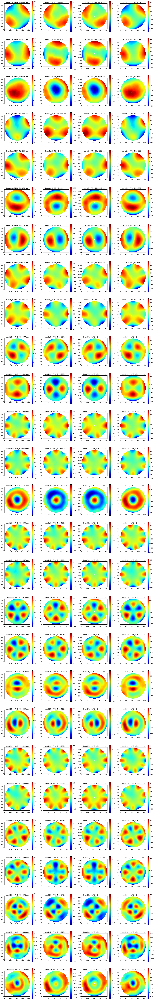

In [3]:
#look at all the +--+ maps
startmode = 1
endmode = 27
nmode = endmode - startmode+1
ts_array = []
fig, ax = plt.subplots(nmode,4,figsize=(20,5*nmode))
i = 0
for modeID in range(startmode,endmode+1):
    signedBend = ['set1*bm%d+'%modeID, 'set1*bm%d-'%modeID, 'set2*bm%d-'%modeID, 'set2*bm%d+'%modeID]
    for bend in signedBend:
        irow = np.int8(i/4)
        icol = np.mod(i,4)
        i += 1
        
        globstring = '%s/Sec 10/*%s*.h5'%(ml_data_dir, bend) #not using dateID. Data split into 0117 and 0121
        #print(globstring)
        fileset = sorted(glob.glob(globstring))
        m1s,centerRow,centerCol,pixelSize, ts = readH5Map(fileset)
        ts_array.append(ts)
        m1rms = np.std(m1s[~np.isnan(m1s)])*1000 #convert into nm

        img = ax[irow][icol].imshow(m1s, origin='lower')
        fig.colorbar(img, ax=ax[irow][icol])
        ax[irow][icol].set_title('bend%d,%s, RMS_M1=%.0f nm'%(modeID, bend[-1], m1rms))

In [4]:
len(ts_array)/4

27.0

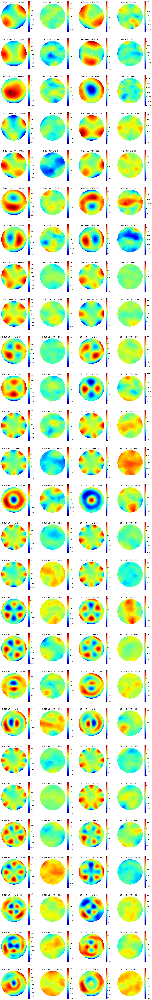

In [9]:
#look at average and diff of each ++ pair and each -- pair
stats = np.zeros((4, nmode))
fig, ax = plt.subplots(nmode,4,figsize=(20,5*nmode))
i = 0
for modeID in range(startmode,endmode+1):

    aveplus = np.zeros_like(m1s)
    aveminus = np.zeros_like(m1s)
    diffplus = np.zeros_like(m1s)
    diffminus = np.zeros_like(m1s)
    signedBend = ['set1*bm%d+'%modeID, 'set1*bm%d-'%modeID, 'set2*bm%d-'%modeID, 'set2*bm%d+'%modeID]
    signshort = '+--+'
    for bend in signedBend:

        globstring = '%s/Sec 10/*%s*.h5'%(ml_data_dir, bend) #not using dateID. Data split into 0117 and 0121
        #print(globstring)
        fileset = sorted(glob.glob(globstring))
        #print(fileset)
        m1s,centerRow,centerCol,pixelSize, ts = readH5Map(fileset, verbose=False)
        if '+' in bend:
            aveplus += m1s
            if 'set1' in bend:
                diffplus -= m1s
            else:
                diffplus += m1s #set2 - set1
                aveplus /= 2
        else:
            aveminus += m1s
            if 'set1' in bend:
                diffminus -= m1s
            else:
                diffminus += m1s
                aveminus /= 2
    for j in range(4):
        irow = np.int8(i/4)
        icol = np.mod(i,4)
        i += 1
        if j==0:
            m1s = aveplus
            img = ax[irow][icol].imshow(m1s, origin='lower')
            fig.colorbar(img, ax=ax[irow][icol])
            m1rms = np.std(m1s[~np.isnan(m1s)])*1000 #convert into nm
            mytitle = 'BM%d, +Mean, RMS=%.0f nm'%(modeID, m1rms)
        elif j==1:
            m1s = diffplus
            img = ax[irow][icol].imshow(m1s, origin='lower')
            fig.colorbar(img, ax=ax[irow][icol])
            m1rms = np.std(m1s[~np.isnan(m1s)])*1000 #convert into nm
            mytitle = 'BM%d, +Diff, RMS=%.0f nm'%(modeID, m1rms)           
        elif j==2:
            m1s = aveminus
            img = ax[irow][icol].imshow(m1s, origin='lower')
            fig.colorbar(img, ax=ax[irow][icol])
            m1rms = np.std(m1s[~np.isnan(m1s)])*1000 #convert into nm
            mytitle = 'BM%d, -Mean, RMS=%.0f nm'%(modeID, m1rms)
        elif j==3:
            m1s = diffminus
            img = ax[irow][icol].imshow(m1s, origin='lower')
            fig.colorbar(img, ax=ax[irow][icol])
            m1rms = np.std(m1s[~np.isnan(m1s)])*1000 #convert into nm
            mytitle = 'BM%d, -Diff, RMS=%.0f nm'%(modeID, m1rms)  
        ax[irow][icol].set_title(mytitle)
        ax[irow][icol].axis('off')
        stats[j, modeID-1] = m1rms

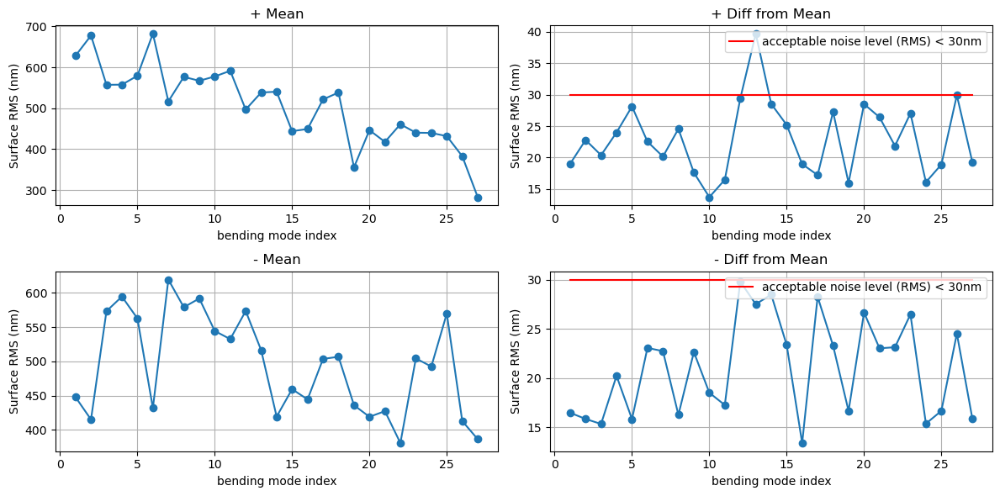

In [10]:
fig, ax = plt.subplots(2,2,figsize=(12, 6))
x0 = np.arange(startmode, endmode+1)
i = 0
j = 0
ax[i][j].plot(x0, stats[0,:],'-o')
ax[i][j].grid()
ax[i][j].set_xlabel('bending mode index')
ax[i][j].set_title('+ Mean')
ax[i][j].set_ylabel('Surface RMS (nm)')
i = 0
j = 1
ax[i][j].plot(x0, stats[j,:]/2,'-o')
ax[i][j].plot([1, nmode],[30,30],'-r', label='acceptable noise level (RMS) < 30nm')
ax[i][j].grid()
ax[i][j].legend(loc='upper right')
ax[i][j].set_xlabel('bending mode index')
ax[i][j].set_title('+ Diff from Mean')
ax[i][j].set_ylabel('Surface RMS (nm)')
i = 1
j = 0
ax[i][j].plot(x0, stats[2,:],'-o')
ax[i][j].grid()
ax[i][j].set_xlabel('bending mode index')
ax[i][j].set_title('- Mean')
ax[i][j].set_ylabel('Surface RMS (nm)')
i = 1
j = 1
ax[i][j].plot(x0, stats[3,:]/2,'-o')
ax[i][j].plot([1, nmode],[30,30],'-r', label='acceptable noise level (RMS) < 30nm')
ax[i][j].grid()
ax[i][j].legend(loc='upper right')
ax[i][j].set_xlabel('bending mode index')
ax[i][j].set_title('- Diff from Mean')
ax[i][j].set_ylabel('Surface RMS (nm)')
plt.tight_layout()

### Now calculate the measured BMs

In [11]:
df = pd.read_csv('../test_input_data/BM_amp_sec10.csv')
bmMags = np.array(df['  S RMS(nm)'])/1000.
bmMags[26-1] = 300/1000. #changed in order to avoid actuator force limit (on the quads)
bmMags[27-1] = 180/1000. #changed in order to avoid actuator force limit (on the quads)

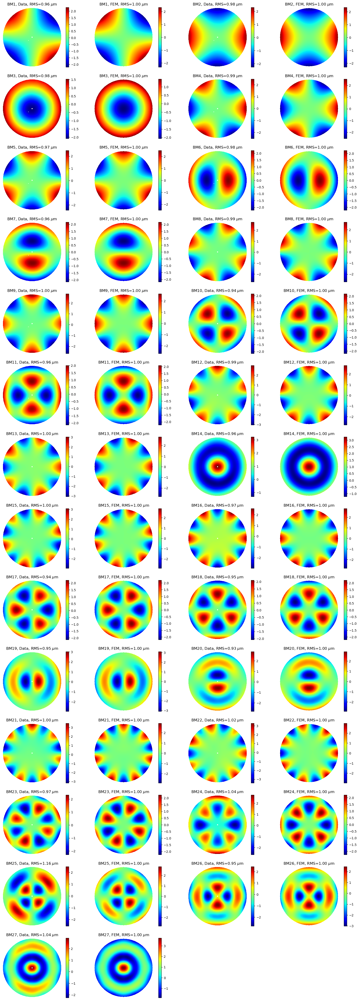

In [12]:
from scipy.interpolate import griddata

GMT_FEM = 1 #GMT FEM

#ML FEM; at least visually, this doesn't seem to help; 
#The Afn_ml@VMat are not orthogonal, therefore cannot be used for decomposition.
#GMT_FEM = 0 #ML FEM

[x1, y1] = mkXYGrid(m1s, centerRow, centerCol, pixelSize)

myBM = np.zeros((Sxn, Syn, nmode))
nrow = int(np.ceil(nmode/2.))
fig, ax = plt.subplots(nrow,4,figsize=(20,4*nrow))

i = 0
for modeID in range(startmode,endmode+1):

    signedBend = ['set1*bm%d+'%modeID, 'set1*bm%d-'%modeID, 'set2*bm%d-'%modeID, 'set2*bm%d+'%modeID]
    signshort = '+--+'    
    for bend in signedBend:
        globstring = '%s/Sec 10/*%s*-.h5'%(ml_data_dir,bend) #not using dateID. Data split into 0117 and 0121
        #print(globstring)
        fileset = sorted(glob.glob(globstring))
        #print(fileset)
        m1s,centerRow,centerCol,pixelSize, ts = readH5Map(fileset, verbose=False)
        if '+' in bend:
            myBM[:,:,modeID-startmode] += m1s
        else:
            myBM[:,:,modeID-startmode] -= m1s
    myBM[:,:,modeID-startmode] /= (4*bmMags[modeID-1]) #normalize to 1um RMS surfaces
    myBM[:,:,modeID-startmode] = -myBM[:,:,modeID-startmode].T #convert into M1B
    m1s = myBM[:,:,modeID-startmode]
    m1rms = np.std(m1s[~np.isnan(m1s)])

    irow = np.int8(i/4)
    icol = np.mod(i,4)
    i += 1
    
    img = ax[irow][icol].imshow(m1s, origin='lower')
    fig.colorbar(img, ax=ax[irow][icol])
    mytitle = r'BM%d, Data, RMS=%.2f $\mu$m'%(modeID, m1rms)
    ax[irow][icol].set_title(mytitle)
    ax[irow][icol].axis('off')
    
    irow = np.int8(i/4)
    icol = np.mod(i,4)
    i += 1
    
    if GMT_FEM:
        aa = UMat[:,modeID-1]
        m1rms = np.std(aa[~np.isnan(aa)])
        grid_z = griddata((nodex, nodey), UMat[:,modeID-1], (x1,y1), method='linear')
    else:
        ss_mlgrid = Afn_ml @ gmt165Fvec2mlFvec(VMat[:,modeID-1]) * 1e-3
        m1rms = np.std(ss_mlgrid[~np.isnan(ss_mlgrid)])
        grid_z = griddata((np.squeeze(nodex_ml), np.squeeze(nodey_ml)), ss_mlgrid, (x1,y1), method='linear')
    #img = ax[irow][icol].scatter(nodex, nodey,10, UMat[:,modeID-1]) #scatter makes image sampling bad
    img = ax[irow][icol].imshow(grid_z, origin='lower')
    
    ax[irow][icol].set_title(r'BM%d, FEM, RMS=%.2f $\mu$m'%(modeID,m1rms))
    ax[irow][icol].axis('equal')
    ax[irow][icol].axis('off')
    fig.colorbar(img, ax=ax[irow][icol])
    
for i in range(nmode*2, nrow*4):
    irow = np.int8(i/4)
    icol = np.mod(i,4)
    ax[irow][icol].axis('off')

In [14]:
bmMags[:endmode]

array([0.5  , 0.5  , 0.5  , 0.5  , 0.5  , 0.5  , 0.5  , 0.5  , 0.5  ,
       0.5  , 0.5  , 0.5  , 0.5  , 0.471, 0.403, 0.403, 0.492, 0.493,
       0.342, 0.39 , 0.345, 0.339, 0.416, 0.378, 0.377, 0.3  , 0.18 ])

### Making the fits & derive xtalks

BM1, Scaling =0.950, Residual RMS = 0.011 $\mu$m (per 1 micron RMS expected)
BM2, Scaling =0.973, Residual RMS = 0.009 $\mu$m (per 1 micron RMS expected)
BM3, Scaling =0.985, Residual RMS = 0.008 $\mu$m (per 1 micron RMS expected)
BM4, Scaling =0.968, Residual RMS = 0.016 $\mu$m (per 1 micron RMS expected)
BM5, Scaling =0.969, Residual RMS = 0.011 $\mu$m (per 1 micron RMS expected)
BM6, Scaling =0.977, Residual RMS = 0.023 $\mu$m (per 1 micron RMS expected)
BM7, Scaling =0.966, Residual RMS = 0.023 $\mu$m (per 1 micron RMS expected)
BM8, Scaling =0.971, Residual RMS = 0.024 $\mu$m (per 1 micron RMS expected)
BM9, Scaling =0.973, Residual RMS = 0.023 $\mu$m (per 1 micron RMS expected)
BM10, Scaling =0.946, Residual RMS = 0.018 $\mu$m (per 1 micron RMS expected)
BM11, Scaling =0.959, Residual RMS = 0.014 $\mu$m (per 1 micron RMS expected)
BM12, Scaling =0.967, Residual RMS = 0.029 $\mu$m (per 1 micron RMS expected)
BM13, Scaling =0.973, Residual RMS = 0.023 $\mu$m (per 1 micron RMS expec

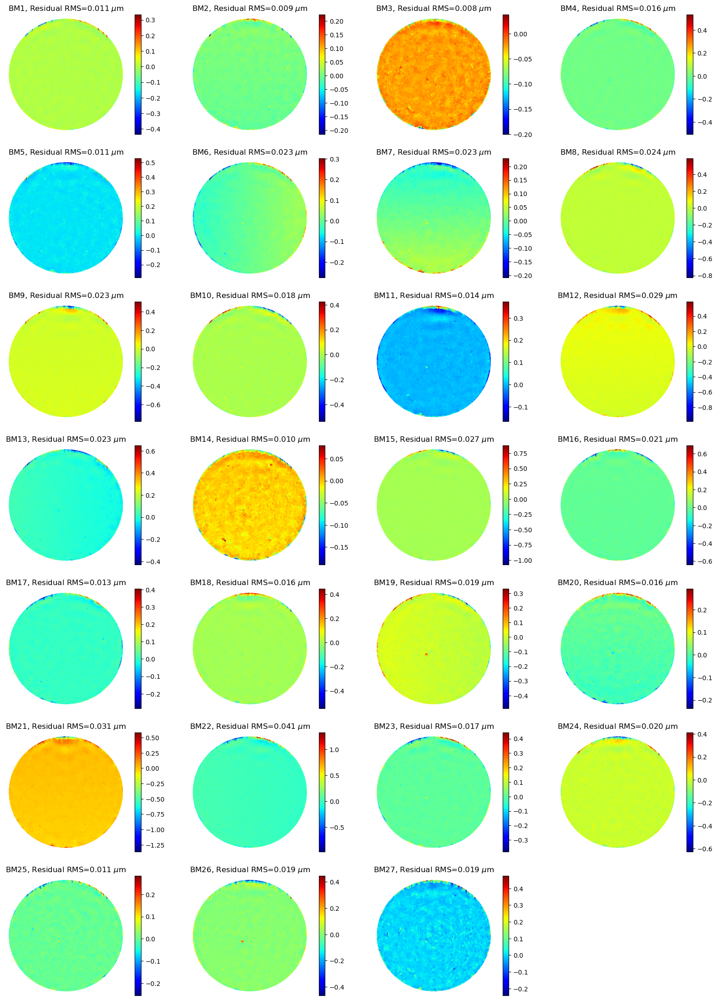

In [25]:
#This takes ~ minutes to run
from scipy.interpolate import LinearNDInterpolator 

nfitmode = 162
xtalk = np.zeros((nfitmode, endmode))

nrow = int(np.ceil(nmode/4.))
fig, ax = plt.subplots(nrow,4,figsize=(20,4*nrow))
i = 0
for i in range(nmode):
    irow = np.int8(i/4)
    icol = np.mod(i,4)
    i += 1

    modeID = i-1+startmode
    bm2d = np.squeeze(myBM[:,:,i-1]) #myIF is already in M1B, in nm
    mask = ~np.isnan(bm2d)

    interp = LinearNDInterpolator(list(zip(x1[mask], y1[mask])), bm2d[mask], fill_value=0)
    mapOntoGMTFEgrid = interp(nodex, nodey).ravel()
    xtalk[:,modeID-1] = UMat[:,:nfitmode].transpose() / UMat.shape[0]  @ mapOntoGMTFEgrid #all in micron
    residual = mapOntoGMTFEgrid - UMat[:,:nfitmode] @ xtalk[:, modeID-1] #this is residual in micron
    
    m1rms = np.std(residual[~np.isnan(residual)]) #in micron
    mytitle = r'BM%d, Scaling =%.3f, Residual RMS = %.3f $\mu$m (per 1 micron RMS expected)'%(modeID, 
                                                                        np.max(xtalk[:,modeID-1]),
                                                                        m1rms)
    print(mytitle)
    img = ax[irow][icol].scatter(nodex, nodey, 10, residual)
    fig.colorbar(img, ax=ax[irow][icol])
    mytitle = r'BM%d, Residual RMS=%.3f $\mu$m'%(modeID, m1rms)

    ax[irow][icol].set_title(mytitle)
    ax[irow][icol].axis('off')
for i in range(nmode, nrow*4):
    irow = np.int8(i/4)
    icol = np.mod(i,4)
    ax[irow][icol].axis('off')
print('scaling factor <1 means mirror stiffer than FEM, i.e., model too soft.')

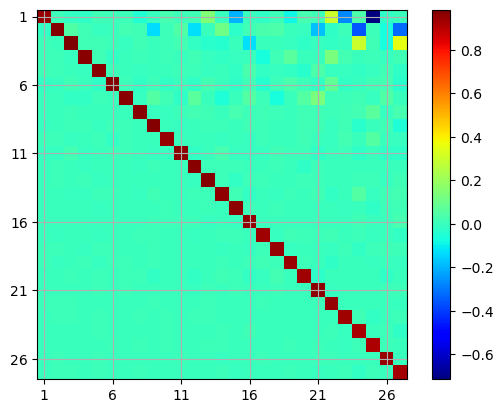

In [26]:
xtalk_sqaure = xtalk[:endmode, :]
plt.imshow(xtalk_sqaure)
rows, cols = xtalk_sqaure.shape
i = 5
plt.xticks(ticks=np.arange(0,cols,i), labels=np.arange(1, cols + 1,i))
plt.yticks(ticks=np.arange(0,rows,i), labels=np.arange(1, rows + 1,i))
plt.grid()
plt.colorbar();

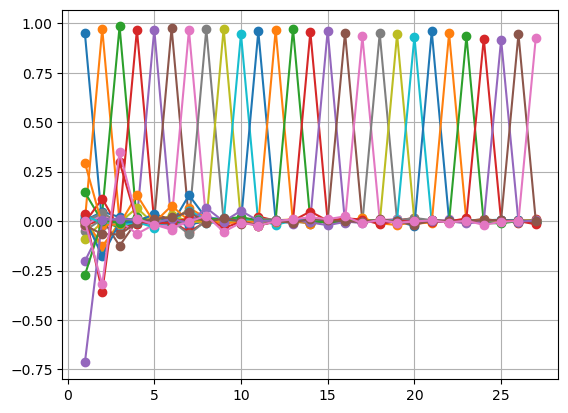

In [27]:
plt.plot(range(1,endmode+1),xtalk_sqaure,'-o');
#plt.plot(range(1,nfitmode+1),xtalk,'-o');
plt.grid();

BM 25
max = +0.07
min = -0.72


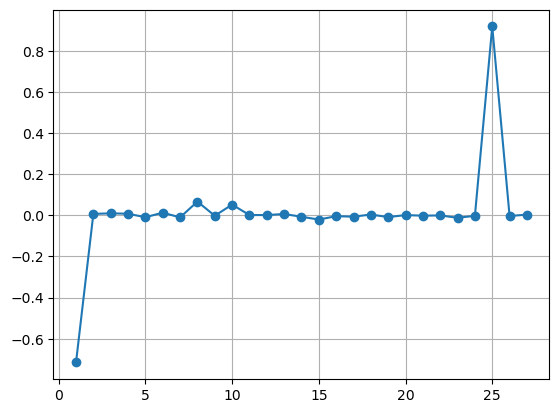

In [28]:
#change this modeID to see coeff for an individual mode
modeID = 25
plt.plot(range(1,endmode+1),xtalk_sqaure[:,modeID-1],'-o');
#plt.plot(range(1,nfitmode+1),xtalk[:,modeID-1],'-o');
plt.grid();
aa = xtalk_sqaure[:,modeID-1].copy()
print('BM %d'%modeID)
aa[aa>0.8] = 0
print('max = %+.2f'%aa[np.argmax(aa)])
print('min = %+.2f'%aa[np.argmax(-aa)])

In [29]:
np.argmax(-aa[aa<0.8])+1

1

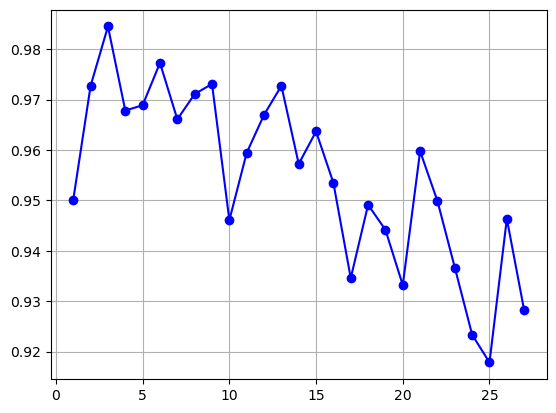

In [30]:
plt.plot(np.arange(1, endmode+1), np.diag(xtalk), '-bo')
plt.grid();

### Check T

In [37]:
modeID = 25
t1 = (modeID-27)*4-4 #these are indices for locating the timestamps
t2 = t1+1
t3 = t1+2
t4 = t1+3
print(ts_array[t1], '\n', ts_array[t2], '\n', ts_array[t3], '\n', ts_array[t4])

Tue Jan 21 15:17:08 2025 
 Tue Jan 21 15:21:20 2025 
 Tue Jan 21 15:24:41 2025 
 Tue Jan 21 15:28:50 2025


----------------   Tue Jan 21 15:17:08 2025
m1_s1_thermal_ctrl/i/tc_temperature/value
2025-01-21 15:17:08  duration =  100  s
(1, 6, 32)
(1, 192)
----------------   Tue Jan 21 15:21:20 2025
m1_s1_thermal_ctrl/i/tc_temperature/value
2025-01-21 15:21:20  duration =  100  s
(1, 6, 32)
(1, 192)
----------------   Tue Jan 21 15:24:41 2025
m1_s1_thermal_ctrl/i/tc_temperature/value
2025-01-21 15:24:41  duration =  100  s
(1, 6, 32)
(1, 192)
----------------   Tue Jan 21 15:28:50 2025
m1_s1_thermal_ctrl/i/tc_temperature/value
2025-01-21 15:28:50  duration =  100  s
(1, 6, 32)
(1, 192)


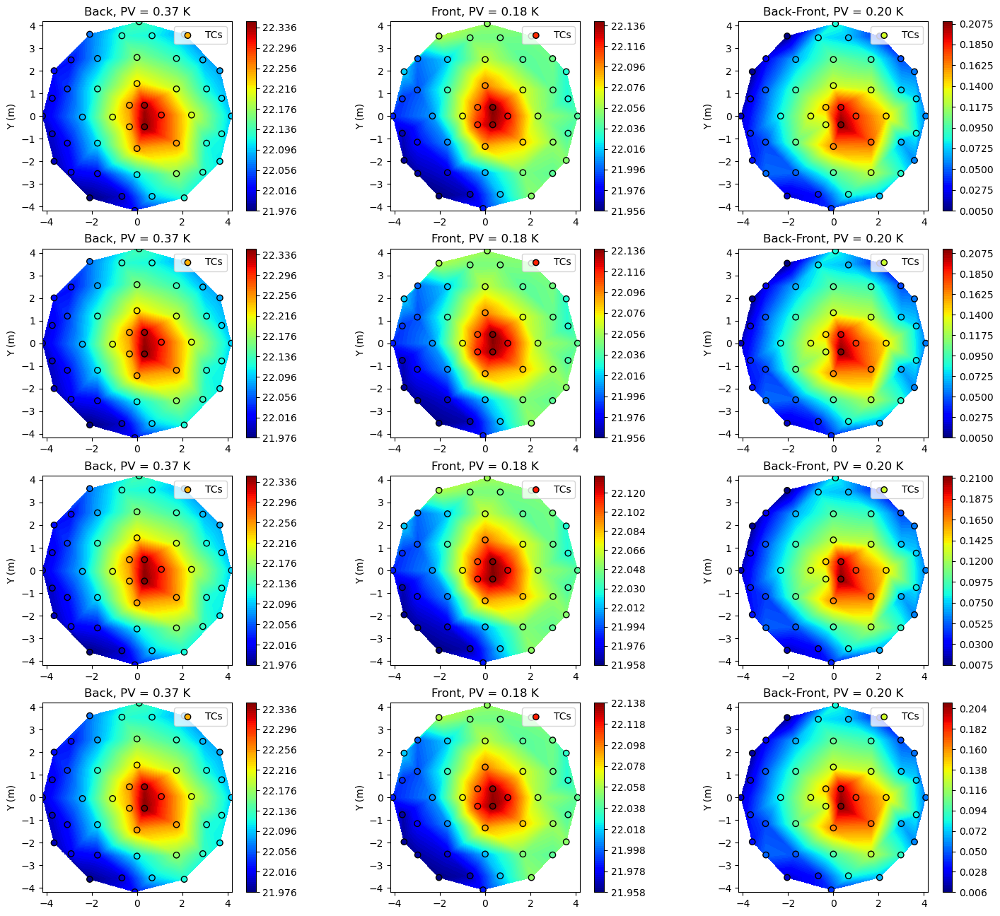

In [38]:
showTMaps([ts_array[t1], ts_array[t2], ts_array[t3], ts_array[t4]])

### Measurement noise?

In [41]:
#for 1um of bm25, we see 0.72um of bm1
print("for 377nm of bm25 measured, there were %.0f nm bm1 produced"%(0.72*377))
print("if this much bm1 were also present due to measurement noise, scaling factor for bm1 would have been %.2f"%(
(500+271)/500))

for 377nm of bm25 measured, there were 271 nm bm1 produced
if this much bm1 were also present due to measurement noise, scaling factor for bm1 would have been 1.54


### Check force telemetry: force differential

In [50]:
print(t1, t2)
sa_force1, tt = getDBData(unix_ts(ts_array[t1])-10,'m1_s1_support_ctrl/s/sa_force/value', duration_in_s=2, samples=10)
sa_force1_z = np.mean(sa_force1,axis=0)[:,2]
print(sa_force1_z.shape)
sa_force2, tt = getDBData(unix_ts(ts_array[t2])-10,'m1_s1_support_ctrl/s/sa_force/value', duration_in_s=2, samples=10)
sa_force2_z = np.mean(sa_force2,axis=0)[:,2]
print(sa_force2_z.shape)
sa_force3, tt = getDBData(unix_ts(ts_array[t3])-10,'m1_s1_support_ctrl/s/sa_force/value', duration_in_s=2, samples=10)
sa_force3_z = np.mean(sa_force3,axis=0)[:,2]
print(sa_force3_z.shape)
sa_force4, tt = getDBData(unix_ts(ts_array[t4])-10,'m1_s1_support_ctrl/s/sa_force/value', duration_in_s=2, samples=10)
sa_force4_z = np.mean(sa_force4,axis=0)[:,2]
print(sa_force4_z.shape)

-12 -11
m1_s1_support_ctrl/s/sa_force/value
2025-01-21 15:16:58  duration =  2  s
(10, 170, 3)
(10, 170, 3)
(170,)
m1_s1_support_ctrl/s/sa_force/value
2025-01-21 15:21:10  duration =  2  s
(10, 170, 3)
(10, 170, 3)
(170,)
m1_s1_support_ctrl/s/sa_force/value
2025-01-21 15:24:31  duration =  2  s
(10, 170, 3)
(10, 170, 3)
(170,)
m1_s1_support_ctrl/s/sa_force/value
2025-01-21 15:28:40  duration =  2  s
(10, 170, 3)
(10, 170, 3)
(170,)


In [46]:
expectedF = gmt165Fvec2gmt170Fvec(VMat[:, modeID-1])

input forces and output figure both in M1B


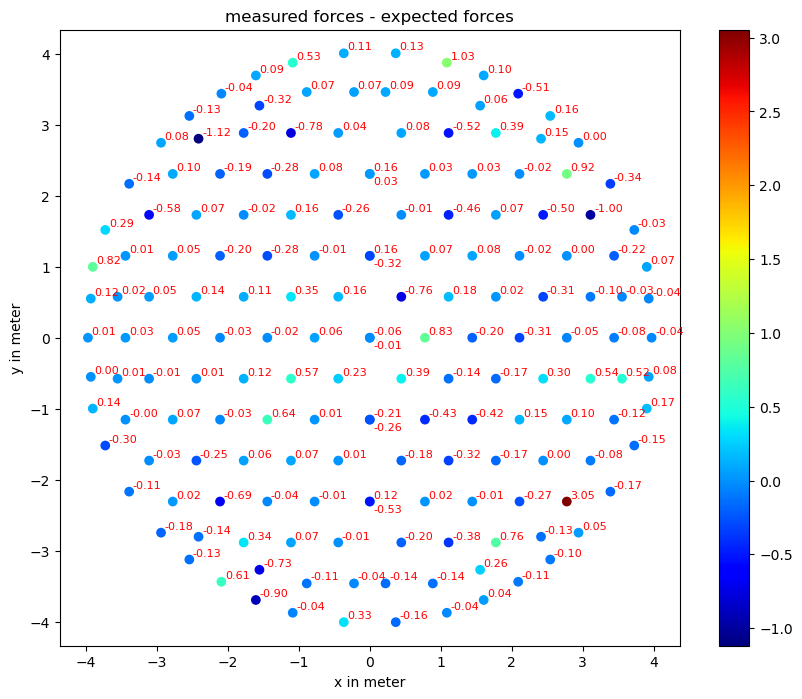

In [51]:
fdiff1 = (sa_force1_z-sa_force2_z)/2 - expectedF*bmMags[modeID-1]
showForceMap_M1B(fdiff1, 'measured forces - expected forces', precision=2)
#showForceMap_M1B(expectedF*bmMags[modeID-1], 'bb')

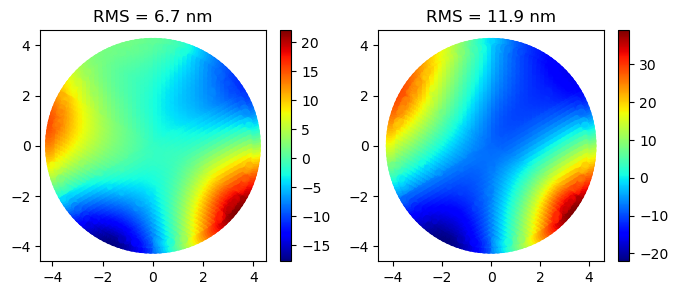

In [56]:
fdiff2 = (sa_force4_z-sa_force3_z)/2 - expectedF*bmMags[modeID-1]

fig, ax = plt.subplots(1,2, figsize=(8,3))
sdiff1 = Afz @ gmt170Fvec2gmt165Fvec(fdiff1)*1e9 #convert to nm
img = ax[0].scatter(nodex, nodey, 10,  sdiff1)
aarms = np.nanstd(sdiff1)
ax[0].set_title('RMS = %.1f nm'%aarms)
ax[0].axis('equal')
fig.colorbar(img, ax=ax[0])
sdiff2 = Afz @ gmt170Fvec2gmt165Fvec(fdiff2)*1e9 #convert to nm
img = ax[1].scatter(nodex, nodey, 10,  sdiff2)
aarms = np.nanstd(sdiff2)
ax[1].set_title('RMS = %.1f nm'%aarms)
fig.colorbar(img, ax=ax[1]);

### force command vs what we wanted to apply

25 -12 command_1737497569.txt
(165,)


Text(0.5, 1.0, 'bending force command - what should be appled')

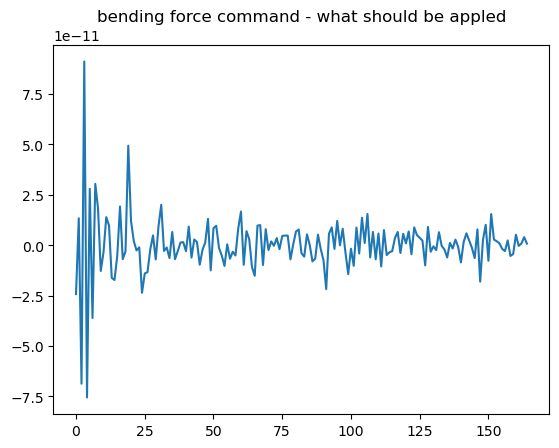

In [59]:
df = pd.read_csv(ml_data_dir+'/../../initial_optimized_forces.txt', header=None)
fpart2 = np.array(df[1])
filename = find_cmd_file(ml_data_dir+ "/../../cmd_logs/", unix_ts(ts_array[t1]))
print(modeID, t1, filename.split('/')[-1])
df = pd.read_csv(filename, header=None)
mlbfp1 = np.array(df[1])
print(mlbfp1.shape)

mysign = 1
if np.mod(t1,4)==2 or np.mod(t1,4)==1:
    mysign = -1
plt.plot(mlbfp1-fpart2-mysign*VMat[:,modeID-1]*bmMags[modeID-1])
plt.title('bending force command - what should be appled')

### what we sent to ML vs what we wanted to apply

25 initial_optimized_forces_bm25_p377.txt
(165,)


Text(0.5, 1.0, 'bending force command - what should be appled')

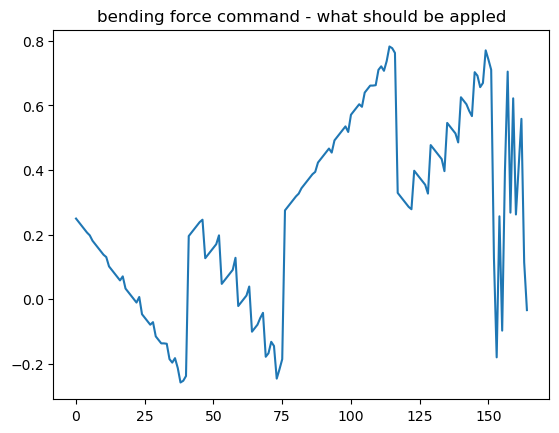

In [60]:
mysign = 'p'

df = pd.read_csv(ml_data_dir+'/../../initial_optimized_forces.txt', header=None)
fpart2 = np.array(df[1])

filename = glob.glob(ml_data_dir+'/../../section_10/initial_optimized_forces_bm%d_%s%d.txt'%(
    modeID,mysign, bmMags[modeID-1]*1000))[0]
print(modeID, filename.split('/')[-1])
df = pd.read_csv(filename, header=None)
mlbfp2 = np.array(df[1])
print(mlbfp2.shape)

if mysign=='p':
    mysign = 1
else:
    mysign = -1
plt.plot(mlbfp2-fpart2-mysign*VMat[:,modeID-1]*bmMags[modeID-1])
plt.title('bending force command - what should be appled')

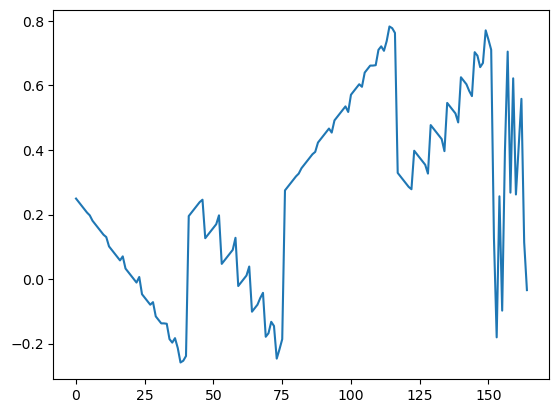

In [63]:
plt.plot(mlbfp2-mlbfp1);

In [ ]:
fdiff = mlbfp-fpart2-mysign*VMat[:,modeID-1]*bmMags[modeID-1]
aa = Afz @ fdiff*1e9 #convert to nm
plt.scatter(nodex, nodey, 10,  aa)
aarms = np.nanstd(aa)
plt.title('RMS = %.1f nm'%aarms)
plt.colorbar();

In [ ]:
showForceMap_M1B(gmt165Fvec2gmt170Fvec(fdiff),'fdiff', precision=2)
np.nanstd(fdiff)

In [ ]:
aa.shape